In [1]:
import pandas as pd
import numpy as np
import requests
import seaborn as sns

In [2]:
df_2016 = pd.read_csv('Dhaka_PM2.5_2016.csv')
df_2017 = pd.read_csv('Dhaka_PM2.5_2017.csv')
df_2018 = pd.read_csv('Dhaka_PM2.5_2018.csv')
df_2019 = pd.read_csv('Dhaka_PM2.5_2019.csv')
df_2020 = pd.read_csv('Dhaka_PM2.5_2020.csv')
df_2021 = pd.read_csv('Dhaka_PM2.5_2021.csv')
df_2022 = pd.read_csv('Dhaka_PM2.5_2022.csv')
df_2023 = pd.read_csv('Dhaka_PM2.5_2023.csv')

In [3]:
df = pd.concat([df_2023,df_2022,df_2021,df_2020,df_2019,df_2018,df_2017,df_2016])
df.head()

,Date (LT),Hour,NowCast Conc.,AQI,AQI Category,Raw Conc.,Conc. Unit,QC Name
0,1/1/2023 1:00,1,297.6,348,Hazardous,340,UG/M3,Valid
1,1/1/2023 2:00,2,254.8,305,Hazardous,212,UG/M3,Valid
2,1/1/2023 3:00,3,217.7,268,Very Unhealthy,179,UG/M3,Valid
3,1/1/2023 4:00,4,199.9,250,Very Unhealthy,180,UG/M3,Valid
4,1/1/2023 5:00,5,173.7,224,Very Unhealthy,149,UG/M3,Valid


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 60620 entries, 0 to 8783
Data columns (total 8 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Date (LT)      60620 non-null  object 
 1   Hour           60620 non-null  int64  
 2   NowCast Conc.  60620 non-null  float64
 3   AQI            60620 non-null  int64  
 4   AQI Category   58760 non-null  object 
 5   Raw Conc.      60620 non-null  int64  
 6   Conc. Unit     60620 non-null  object 
 7   QC Name        60620 non-null  object 
dtypes: float64(1), int64(3), object(4)
memory usage: 4.2+ MB


In [5]:
print(df.columns)


Index(['Date (LT)', 'Hour', 'NowCast Conc.', 'AQI', 'AQI Category',
       'Raw Conc.', 'Conc. Unit', 'QC Name'],
      dtype='object')


# Accuracy 

In [6]:
df.columns= df.columns.str.lower()

In [7]:
df.columns = df.columns.str.replace(' ', '_')

In [8]:
df.head()

,date_(lt),hour,nowcast_conc.,aqi,aqi_category,raw_conc.,conc._unit,qc_name
0,1/1/2023 1:00,1,297.6,348,Hazardous,340,UG/M3,Valid
1,1/1/2023 2:00,2,254.8,305,Hazardous,212,UG/M3,Valid
2,1/1/2023 3:00,3,217.7,268,Very Unhealthy,179,UG/M3,Valid
3,1/1/2023 4:00,4,199.9,250,Very Unhealthy,180,UG/M3,Valid
4,1/1/2023 5:00,5,173.7,224,Very Unhealthy,149,UG/M3,Valid


In [9]:
df['date_(lt)'] = pd.to_datetime(df['date_(lt)'], format='mixed')

In [10]:
df.rename(columns={'date_(lt)': 'date'}, inplace=True)
df['date'] = pd.to_datetime(df['date'], format = '%d/%m/%Y %H:%M')

In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 60620 entries, 0 to 8783
Data columns (total 8 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   date           60620 non-null  datetime64[ns]
 1   hour           60620 non-null  int64         
 2   nowcast_conc.  60620 non-null  float64       
 3   aqi            60620 non-null  int64         
 4   aqi_category   58760 non-null  object        
 5   raw_conc.      60620 non-null  int64         
 6   conc._unit     60620 non-null  object        
 7   qc_name        60620 non-null  object        
dtypes: datetime64[ns](1), float64(1), int64(3), object(3)
memory usage: 4.2+ MB


In [12]:
df.isnull().sum()

date                0
hour                0
nowcast_conc.       0
aqi                 0
aqi_category     1860
raw_conc.           0
conc._unit          0
qc_name             0
dtype: int64

In [13]:
df['aqi_category'].fillna('Unknown', inplace=True)

In [14]:
df.isnull().sum()

date             0
hour             0
nowcast_conc.    0
aqi              0
aqi_category     0
raw_conc.        0
conc._unit       0
qc_name          0
dtype: int64

In [15]:
df.columns

Index(['date', 'hour', 'nowcast_conc.', 'aqi', 'aqi_category', 'raw_conc.',
       'conc._unit', 'qc_name'],
      dtype='object')

In [16]:
df['month'] = df['date'].dt.month
df['day'] = df['date'].dt.day
df.head()

,date,hour,nowcast_conc.,aqi,aqi_category,raw_conc.,conc._unit,qc_name,month,day
0,2023-01-01 01:00:00,1,297.6,348,Hazardous,340,UG/M3,Valid,1,1
1,2023-01-01 02:00:00,2,254.8,305,Hazardous,212,UG/M3,Valid,1,1
2,2023-01-01 03:00:00,3,217.7,268,Very Unhealthy,179,UG/M3,Valid,1,1
3,2023-01-01 04:00:00,4,199.9,250,Very Unhealthy,180,UG/M3,Valid,1,1
4,2023-01-01 05:00:00,5,173.7,224,Very Unhealthy,149,UG/M3,Valid,1,1


In [17]:
df.head()

,date,hour,nowcast_conc.,aqi,aqi_category,raw_conc.,conc._unit,qc_name,month,day
0,2023-01-01 01:00:00,1,297.6,348,Hazardous,340,UG/M3,Valid,1,1
1,2023-01-01 02:00:00,2,254.8,305,Hazardous,212,UG/M3,Valid,1,1
2,2023-01-01 03:00:00,3,217.7,268,Very Unhealthy,179,UG/M3,Valid,1,1
3,2023-01-01 04:00:00,4,199.9,250,Very Unhealthy,180,UG/M3,Valid,1,1
4,2023-01-01 05:00:00,5,173.7,224,Very Unhealthy,149,UG/M3,Valid,1,1


In [18]:
df.drop(columns = 'qc_name', inplace = True)

In [19]:
from sklearn.preprocessing import LabelEncoder

In [20]:
LE = LabelEncoder()

In [21]:
df['aqi_le'] = LE.fit_transform(df['aqi_category'])

In [22]:
df.head()

,date,hour,nowcast_conc.,aqi,aqi_category,raw_conc.,conc._unit,month,day,aqi_le
0,2023-01-01 01:00:00,1,297.6,348,Hazardous,340,UG/M3,1,1,1
1,2023-01-01 02:00:00,2,254.8,305,Hazardous,212,UG/M3,1,1,1
2,2023-01-01 03:00:00,3,217.7,268,Very Unhealthy,179,UG/M3,1,1,6
3,2023-01-01 04:00:00,4,199.9,250,Very Unhealthy,180,UG/M3,1,1,6
4,2023-01-01 05:00:00,5,173.7,224,Very Unhealthy,149,UG/M3,1,1,6


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


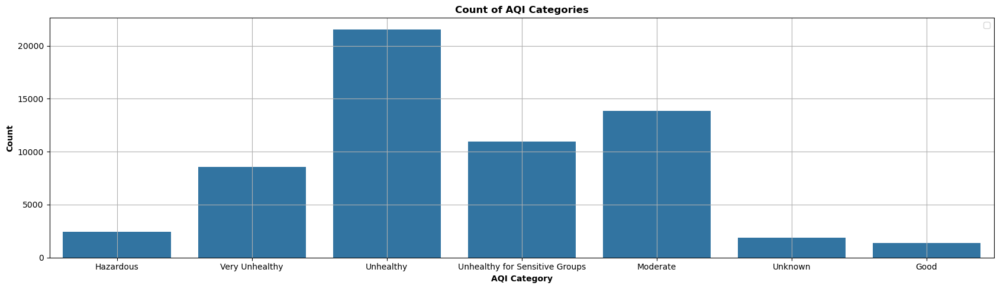

In [23]:
import seaborn as sns
import matplotlib.pyplot as plt
plt.figure(figsize = (17,5))
sns.countplot(x=df['aqi_category'])

plt.xlabel('AQI Category', fontweight = 'bold' )
plt.ylabel('Count', fontweight = 'bold' )
plt.title('Count of AQI Categories', fontweight = 'bold' )
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

In [24]:
main_df = df.drop(columns= ['date','conc._unit'])

In [25]:
main_df['aqi_category'].unique()

array(['Hazardous', 'Very Unhealthy', 'Unhealthy',
       'Unhealthy for Sensitive Groups', 'Moderate', 'Unknown', 'Good'],
      dtype=object)

In [26]:
main_df['aqi_le'].unique()

array([1, 6, 3, 4, 2, 5, 0])

In [27]:
# Defining the mapping of numerical values to AQI categories
aqi_ranking = {
'Hazardous': 6,
'Very Unhealthy': 5,
'Unhealthy for Sensitive Groups': 4,
'Unhealthy': 3,
'Moderate': 2,
'Good': 1,
'Unknown': 0
}

# Create the new column 'aqi_map' and map the numerical values to AQI categories
main_df['aqi_map'] = main_df['aqi_category'].replace(aqi_ranking)
main_df[12:100:12]

,hour,nowcast_conc.,aqi,aqi_category,raw_conc.,month,day,aqi_le,aqi_map
12,13,137.2,193,Unhealthy,134,1,1,3,3
24,1,219.9,270,Very Unhealthy,209,1,2,6,5
36,13,139.6,194,Unhealthy,104,1,2,3,3
48,1,257.5,308,Hazardous,245,1,3,1,6
60,13,196.1,246,Very Unhealthy,191,1,3,6,5
72,1,190.2,240,Very Unhealthy,179,1,4,6,5
84,13,169.9,220,Very Unhealthy,192,1,4,6,5
96,1,187.1,237,Very Unhealthy,185,1,5,6,5


In [28]:
main_df = main_df.drop(columns = ['aqi_le', 'aqi_category'])
main_df

,hour,nowcast_conc.,aqi,raw_conc.,month,day,aqi_map
0,1,297.6,348,340,1,1,6
1,2,254.8,305,212,1,1,6
2,3,217.7,268,179,1,1,5
3,4,199.9,250,180,1,1,5
4,5,173.7,224,149,1,1,5
...,...,...,...,...,...,...,...
8779,20,219.8,270,243,12,31,5
8780,21,256.4,307,293,12,31,6
8781,22,261.7,312,267,12,31,6
8782,23,291.3,341,321,12,31,6


In [29]:
X= main_df.drop(columns = ['aqi_map'])
y = main_df['aqi_map']

<Axes: >

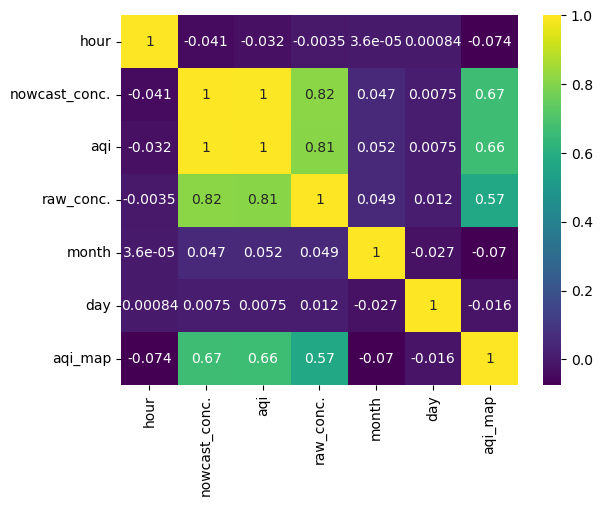

In [30]:
sns.heatmap(main_df.corr(),annot =True, cmap = 'viridis')

In [31]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.30)

In [32]:
#from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.feature_selection import RFECV
from sklearn.metrics import r2_score

In [33]:
#X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20)

In [34]:
rfr = RandomForestRegressor()

In [35]:
rfecv = RFECV(estimator = rfr, cv=5, scoring = 'r2')

In [36]:
rfecv.fit(X_train, y_train)

RFECV(cv=5, estimator=RandomForestRegressor(), scoring='r2')

In [37]:
selected_features = X_train.columns[rfecv.support_]
selected_features

Index(['aqi'], dtype='object')

In [38]:
#Ensembling
# Train the RandomForestRegressor on the selected features
rfr.fit(X_train[selected_features], y_train)

#finally predict on test data
y_pred = rfr.predict(X_test[selected_features])

In [39]:
r2_score(y_test,y_pred)

1.0

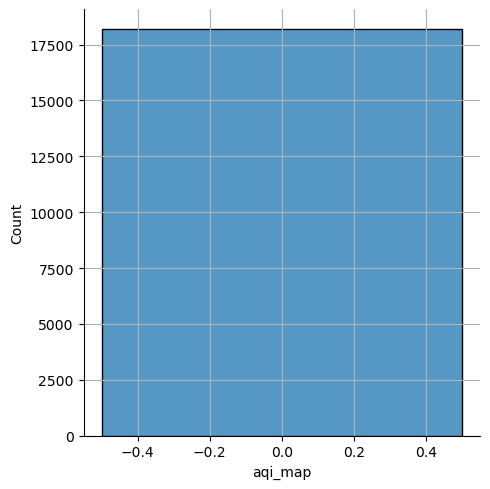

In [40]:
#plotting
import matplotlib.pyplot as plt
sns.displot(y_test-y_pred)
plt.grid(True)
plt.savefig('fig-2.png')

In [41]:
pip install scikit-plot

Note: you may need to restart the kernel to use updated packages.


Train Accuracy 0.994
Test Accuracy 0.991
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       562
           1       0.99      0.96      0.98       453
           2       0.99      1.00      0.99      4188
           3       0.99      1.00      0.99      6453
           4       0.99      0.98      0.98      3305
           5       0.99      0.99      0.99      2508
           6       0.99      0.98      0.99       717

    accuracy                           0.99     18186
   macro avg       0.99      0.99      0.99     18186
weighted avg       0.99      0.99      0.99     18186

[[ 562    0    0    0    0    0    0]
 [   0  436   17    0    0    0    0]
 [   0    3 4170    0   15    0    0]
 [   0    0    0 6436    9    8    0]
 [   0    0   24   53 3228    0    0]
 [   0    0    0   23    0 2479    6]
 [   0    0    0    0    0   13  704]]


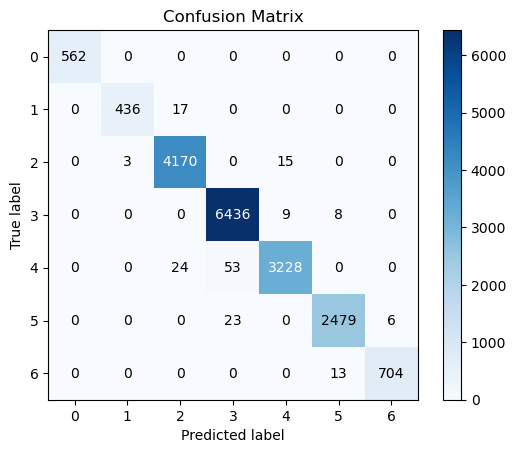

In [42]:
from sklearn.neighbors import KNeighborsClassifier 
from sklearn.metrics import accuracy_score 
from sklearn.metrics import classification_report 
from sklearn.metrics import confusion_matrix 
import scikitplot as skplt 
knn = KNeighborsClassifier(n_neighbors=7) 
knn.fit(X_train, y_train) 
predictions = knn.predict(X_test)
print('Train Accuracy', "{:.3f}".format(accuracy_score (y_train, knn.predict(X_train))))
print('Test Accuracy', "{:.3f}".format(accuracy_score (y_test, predictions)))
print(classification_report(y_test, predictions))
print(confusion_matrix(y_test, predictions))
skplt.metrics.plot_confusion_matrix(y_test, predictions);

In [43]:
#from sklearn.neighbors import KNeighborsClassifier
#from sklearn.model_selection import train_test_split
#from sklearn.metrics import accuracy_score

In [44]:
#X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

In [45]:
# Create a KNN classifier with k=5 neighbors
#knn = KNeighborsClassifier(n_neighbors=5)

In [46]:
# Train the KNN classifier on the training data
#knn.fit(X_train, y_train)

In [47]:
#y_pred = knn.predict(X_test)

In [48]:
# Evaluate the accuracy of the KNN classifier
#accuracy = accuracy_score(y_test, y_pred)
#print('Accuracy:', accuracy)

In [49]:
#from sklearn.svm import SVR
#from sklearn.model_selection import train_test_split
#from sklearn.metrics import mean_squared_error


In [50]:
# Split the data into training and testing sets
#X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

In [51]:
# Create an SVR model with a linear kernel
#svr = SVR(kernel='linear')


In [52]:
# Train the SVR model on the training data
#svr.fit(X_train, y_train)

In [53]:
from sklearn.linear_model import LinearRegression
from sklearn.feature_selection import RFECV
from sklearn.metrics import r2_score, mean_squared_error
import matplotlib.pyplot as plt
import seaborn as sns

In [54]:
# Create a LinearRegression model
lr = LinearRegression()


In [55]:
# Create an RFECV (Recursive Feature Elimination with Cross-Validation) object
rfecv = RFECV(estimator=lr, cv=5, scoring='r2')

In [56]:
# Fit RFECV to your training data
rfecv.fit(X_train, y_train)

RFECV(cv=5, estimator=LinearRegression(), scoring='r2')

In [57]:
# Get the selected features
selected_features = X_train.columns[rfecv.support_]

In [58]:
# Train the LinearRegression model on the selected features
lr.fit(X_train[selected_features], y_train)

LinearRegression()

In [59]:
# Predict on the training data
y_train_pred = lr.predict(X_train[selected_features])

In [60]:
# Predict on the test data
y_test_pred = lr.predict(X_test[selected_features])
print(y_pred)

[3. 3. 2. ... 4. 3. 3.]


In [61]:
# Calculate the R-squared scores for training and test data
r2_train = r2_score(y_train, y_train_pred)
r2_test = r2_score(y_test, y_test_pred)

In [62]:
# Print the R-squared scores
print(f"Training R-squared score: {r2_train}")
print(f"Test R-squared score: {r2_test}")

Training R-squared score: 0.46262933090938974
Test R-squared score: 0.45800291156453066


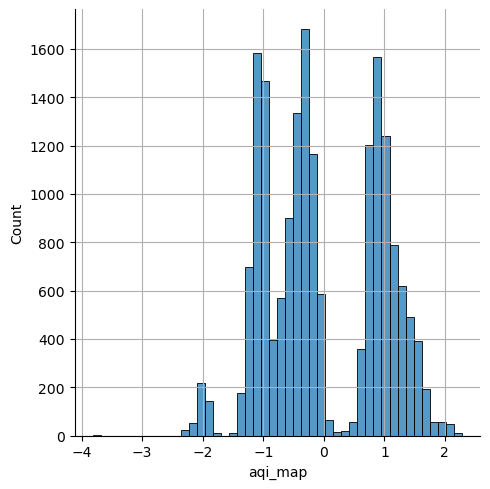

In [63]:
# Plot the residuals
residuals = y_test - y_test_pred
sns.displot(residuals)
plt.grid(True)
plt.savefig('fig-3.png')

In [64]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.feature_selection import RFECV
from sklearn.metrics import r2_score
import matplotlib.pyplot as plt
import seaborn as sns

In [65]:
# Create a DecisionTreeRegressor model
dtr = DecisionTreeRegressor()

In [66]:
# Create an RFECV (Recursive Feature Elimination with Cross-Validation) object
rfecv = RFECV(estimator=dtr, cv=5, scoring='r2')

In [67]:
# Fit RFECV to your training data
rfecv.fit(X_train, y_train)

RFECV(cv=5, estimator=DecisionTreeRegressor(), scoring='r2')

In [68]:
# Get the selected features
selected_features = X_train.columns[rfecv.support_]

In [69]:
# Train the DecisionTreeRegressor model on the selected features
dtr.fit(X_train[selected_features], y_train)

DecisionTreeRegressor()

In [70]:
# Predict on the training data
y_train_pred = dtr.predict(X_train[selected_features])

In [71]:
# Predict on the test data
y_test_pred = dtr.predict(X_test[selected_features])

In [72]:
# Calculate the R-squared scores for training and test data
r2_train = r2_score(y_train, y_train_pred)
r2_test = r2_score(y_test, y_test_pred)

In [73]:
# Print the R-squared scores
print(f"Training R-squared score: {r2_train}")
print(f"Test R-squared score: {r2_test}")

Training R-squared score: 1.0
Test R-squared score: 1.0


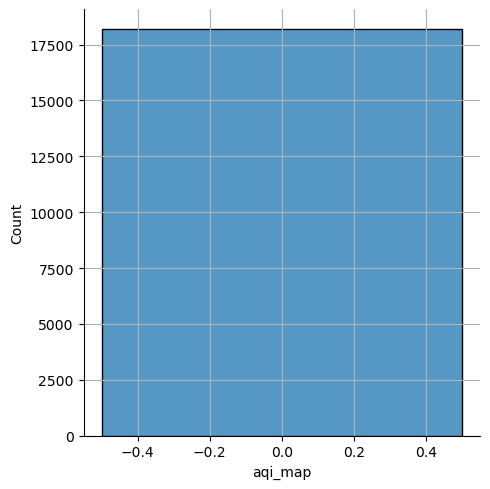

In [74]:
# Plot the residuals
residuals = y_test - y_test_pred
sns.displot(residuals)
plt.grid(True)
plt.savefig('fig-4.png')

In [75]:
pip install xgboost


Note: you may need to restart the kernel to use updated packages.


In [76]:
from xgboost import XGBRegressor
from sklearn.feature_selection import RFECV
from sklearn.metrics import r2_score
import matplotlib.pyplot as plt
import seaborn as sns


In [77]:
# Create an XGBRegressor model
xgb = XGBRegressor()

In [78]:
# Create an RFECV (Recursive Feature Elimination with Cross-Validation) object
rfecv = RFECV(estimator=xgb, cv=5, scoring='r2')

In [79]:
# Fit RFECV to your training data
rfecv.fit(X_train, y_train)

RFECV(cv=5,
      estimator=XGBRegressor(base_score=None, booster=None, callbacks=None,
                             colsample_bylevel=None, colsample_bynode=None,
                             colsample_bytree=None, device=None,
                             early_stopping_rounds=None,
                             enable_categorical=False, eval_metric=None,
                             feature_types=None, gamma=None, grow_policy=None,
                             importance_type=None, interaction_constraints=None,
                             learning_rate=None, max_bin=None,
                             max_cat_threshold=None, max_cat_to_onehot=None,
                             max_delta_step=None, max_depth=None,
                             max_leaves=None, min_child_weight=None,
                             missing=nan, monotone_constraints=None,
                             multi_strategy=None, n_estimators=None,
                             n_jobs=None, num_parallel_tree=None,
                             random_state=None, ...),
      scoring='r2')

In [80]:
# Get the selected features
selected_features = X_train.columns[rfecv.support_]

In [81]:
# Train the XGBoost model on the selected features
xgb.fit(X_train[selected_features], y_train)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=None, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=None, n_jobs=None,
             num_parallel_tree=None, random_state=None, ...)

In [82]:
# Predict on the training data
y_train_pred = xgb.predict(X_train[selected_features])

In [83]:
# Predict on the test data
y_test_pred = xgb.predict(X_test[selected_features])

In [84]:
# Calculate the R-squared scores for training and test data
r2_train = r2_score(y_train, y_train_pred)
r2_test = r2_score(y_test, y_test_pred)

In [85]:
# Print the training and test R-squared scores
print(f"Training R-squared score: {r2_train}")
print(f"Test R-squared score: {r2_test}")

Training R-squared score: 0.9995999507523958
Test R-squared score: 0.9969006973896739


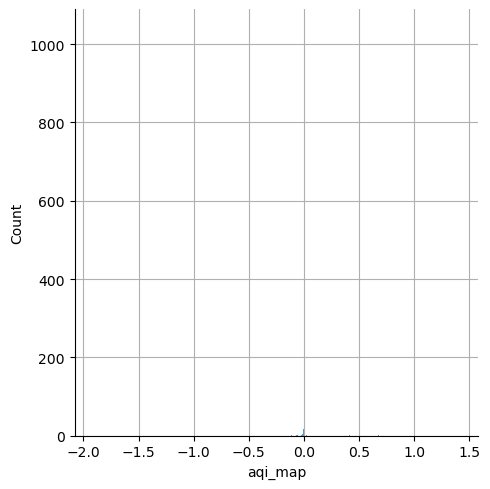

In [86]:
# Plot the residuals
residuals = y_test - y_test_pred
sns.displot(residuals)
plt.grid(True)
plt.savefig('fig-5.png')

In [87]:
from sklearn.linear_model import Lasso
from sklearn.feature_selection import RFECV
from sklearn.metrics import r2_score
import matplotlib.pyplot as plt
import seaborn as sns

In [88]:
# Create a Lasso regression model
lasso = Lasso(alpha=1.0)  # You can adjust the alpha value as needed

# Create an RFECV (Recursive Feature Elimination with Cross-Validation) object
rfecv = RFECV(estimator=lasso, cv=5, scoring='r2')

# Fit RFECV to your training data
rfecv.fit(X_train, y_train)

# Get the selected features
selected_features = X_train.columns[rfecv.support_]

# Train the Lasso model on the selected features
lasso.fit(X_train[selected_features], y_train)

# Predict on the training data
y_train_pred = lasso.predict(X_train[selected_features])

# Predict on the test data
y_test_pred = lasso.predict(X_test[selected_features])

# Calculate the R-squared scores for training and test data
r2_train = r2_score(y_train, y_train_pred)
r2_test = r2_score(y_test, y_test_pred)

# Print the R-squared scores
print(f"Training R-squared score: {r2_train}")
print(f"Test R-squared score: {r2_test}")

Training R-squared score: 0.4489201486552443
Test R-squared score: 0.4447427866253276


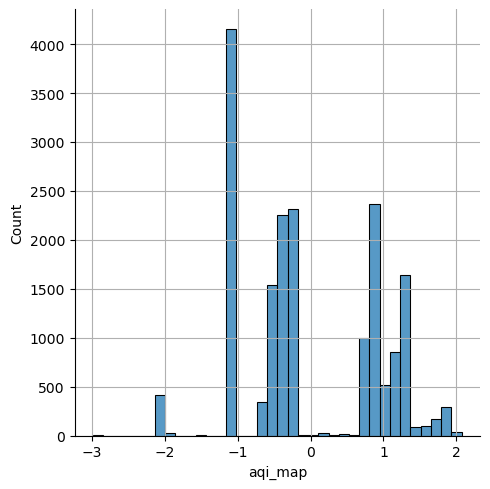

In [89]:

# Plot the residuals
residuals = y_test - y_test_pred
sns.displot(residuals)
plt.grid(True)
plt.savefig('fig-5.png')

# Pandas Profiling 

In [90]:
import pandas as pd
from ydata_profiling import ProfileReport

# List of CSV files
csv_files = [
    'Dhaka_PM2.5_2016.csv',
    'Dhaka_PM2.5_2017.csv',
    'Dhaka_PM2.5_2018.csv',
    'Dhaka_PM2.5_2019.csv',
    'Dhaka_PM2.5_2020.csv',
    'Dhaka_PM2.5_2021.csv',
    'Dhaka_PM2.5_2022.csv',
    'Dhaka_PM2.5_2023.csv'
]

for csv_file in csv_files:
    # Read the CSV file into a DataFrame
    df = pd.read_csv(csv_file)

    # Create a profile report for the DataFrame
    report_title = f"Profiling Report for {csv_file}"
    profile = ProfileReport(df, title=report_title)

    # Generate the report and save it as an HTML file
    output_file = f"report_{csv_file.split('.')[0]}.html"
    profile.to_file(output_file)


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [91]:
#pip install seaborn matplotlib


# Predictions using the Gaussian Naive Bayes classifier

Train Accuracy 0.973
Test Accuracy 0.947
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        21
           1       0.88      1.00      0.94        30
           2       1.00      0.83      0.91        24

    accuracy                           0.95        75
   macro avg       0.96      0.94      0.95        75
weighted avg       0.95      0.95      0.95        75

[[21  0  0]
 [ 0 30  0]
 [ 0  4 20]]


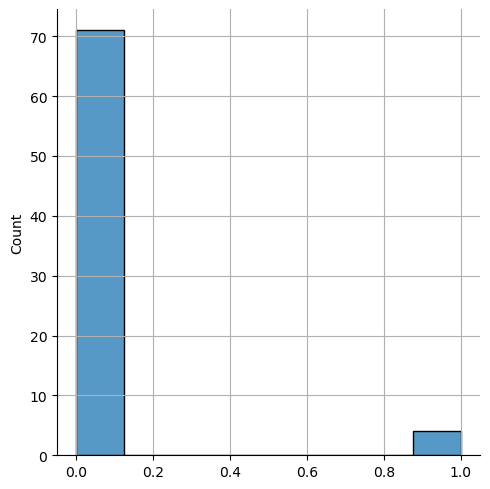

In [92]:
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.datasets import load_iris
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import scikitplot as skplt

# Load the Iris dataset and split it into training and testing sets
X, y = load_iris(return_X_y=True)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=0)

# Create a Gaussian Naive Bayes classifier and fit it on the training data
gnb = GaussianNB()
gnb.fit(X_train, y_train)

# Make predictions using the Gaussian Naive Bayes classifier
y_test_pred = gnb.predict(X_test)

# Calculate and print the training and test accuracy, classification report, and confusion matrix
train_accuracy = accuracy_score(y_train, gnb.predict(X_train))
test_accuracy = accuracy_score(y_test, y_test_pred)
print('Train Accuracy', "{:.3f}".format(train_accuracy))
print('Test Accuracy', "{:.3f}".format(test_accuracy))
print(classification_report(y_test, y_test_pred))
print(confusion_matrix(y_test, y_test_pred))

# Calculate the residuals
residuals = y_test - y_test_pred

# Plot the residuals
sns.displot(residuals)
plt.grid(True)
plt.savefig('fig-6.png')


# Make predictions using the SVM classifier

Train Accuracy 0.973
Test Accuracy 0.973
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        21
           1       0.97      0.97      0.97        30
           2       0.96      0.96      0.96        24

    accuracy                           0.97        75
   macro avg       0.98      0.98      0.98        75
weighted avg       0.97      0.97      0.97        75

[[21  0  0]
 [ 0 29  1]
 [ 0  1 23]]


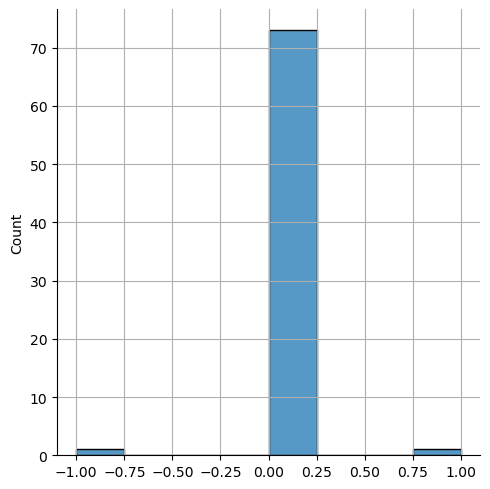

In [93]:
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.datasets import load_iris
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import scikitplot as skplt

# Load the Iris dataset and split it into training and testing sets
X, y = load_iris(return_X_y=True)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=0)

# Create an SVM classifier and fit it on the training data
svm_classifier = SVC(kernel='linear', C=1.0)
svm_classifier.fit(X_train, y_train)

# Make predictions using the SVM classifier
y_test_pred = svm_classifier.predict(X_test)

# Calculate and print the training and test accuracy, classification report, and confusion matrix
train_accuracy = accuracy_score(y_train, svm_classifier.predict(X_train))
test_accuracy = accuracy_score(y_test, y_test_pred)
print('Train Accuracy', "{:.3f}".format(train_accuracy))
print('Test Accuracy', "{:.3f}".format(test_accuracy))
print(classification_report(y_test, y_test_pred))
print(confusion_matrix(y_test, y_test_pred))

# Calculate the residuals
residuals = y_test - y_test_pred

# Plot the residuals
sns.displot(residuals)
plt.grid(True)
plt.savefig('fig-7.png')


# different SVM classifiers in the iris dataset

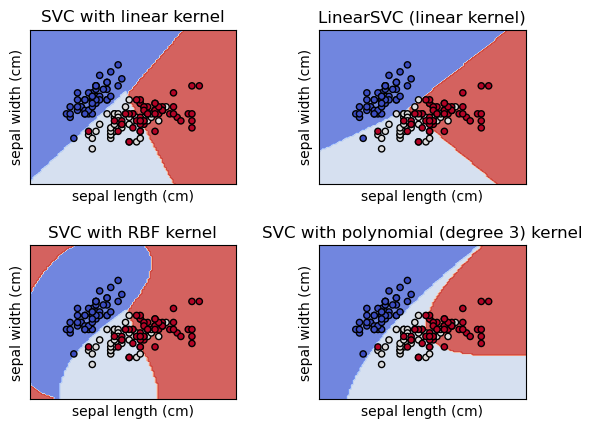

In [94]:
import matplotlib.pyplot as plt
from sklearn import datasets, svm
from sklearn.inspection import DecisionBoundaryDisplay

# import some data to play with
iris = datasets.load_iris()
# Take the first two features. We could avoid this by using a two-dim dataset
X = iris.data[:, :2]
y = iris.target

# we create an instance of SVM and fit our data. We do not scale our
# data since we want to plot the support vectors
C = 1.0  # SVM regularization parameter
models = (
    svm.SVC(kernel="linear", C=C),
    svm.LinearSVC(C=C, max_iter=10000, dual=False),  # Set dual to False
    svm.SVC(kernel="rbf", gamma=0.7, C=C),
    svm.SVC(kernel="poly", degree=3, gamma="auto", C=C),
)
models = (clf.fit(X, y) for clf in models)

# title for the plots
titles = (
    "SVC with linear kernel",
    "LinearSVC (linear kernel)",
    "SVC with RBF kernel",
    "SVC with polynomial (degree 3) kernel",
)

# Set-up 2x2 grid for plotting.
fig, sub = plt.subplots(2, 2)
plt.subplots_adjust(wspace=0.4, hspace=0.4)

X0, X1 = X[:, 0], X[:, 1]

for clf, title, ax in zip(models, titles, sub.flatten()):
    disp = DecisionBoundaryDisplay.from_estimator(
        clf,
        X,
        response_method="predict",
        cmap=plt.cm.coolwarm,
        alpha=0.8,
        ax=ax,
        xlabel=iris.feature_names[0],
        ylabel=iris.feature_names[1],
    )
    ax.scatter(X0, X1, c=y, cmap=plt.cm.coolwarm, s=20, edgecolors="k")
    ax.set_xticks(())
    ax.set_yticks(())
    ax.set_title(title)

plt.show()


# Grid Search 

In [95]:
import pandas as pd

def refit_strategy(cv_results):
    # Convert the results into a DataFrame
    cv_results_ = pd.DataFrame(cv_results)
    print("All grid-search results:")
    print_dataframe(cv_results_)

    # Find the index with the best mean_test_score
    best_index = cv_results_['mean_test_score'].idxmax()

    return best_index

def print_dataframe(filtered_cv_results):
    """Pretty print for filtered dataframe"""
    for mean_score, std_score, params in zip(
        filtered_cv_results["mean_test_score"],
        filtered_cv_results["std_test_score"],
        filtered_cv_results["params"],
    ):
        print(
            f"mean_score: {mean_score:0.3f} (±{std_score:0.03f}), for {params}"
        )

from sklearn.model_selection import GridSearchCV
from sklearn.svm import SVC

tuned_parameters = [
    {"kernel": ["rbf"], "gamma": [1e-3, 1e-4], "C": [1, 10, 100, 1000]},
    {"kernel": ["linear"], "C": [1, 10, 100, 1000]},
]

# Define the scoring metric(s) you want to use
scoring = 'accuracy'  # You can change this to other scoring metrics

grid_search = GridSearchCV(
    SVC(), tuned_parameters, scoring=scoring, refit=refit_strategy
)
grid_search.fit(X_train, y_train)


All grid-search results:
mean_score: 0.627 (±0.090), for {'C': 1, 'gamma': 0.001, 'kernel': 'rbf'}
mean_score: 0.387 (±0.027), for {'C': 1, 'gamma': 0.0001, 'kernel': 'rbf'}
mean_score: 0.933 (±0.073), for {'C': 10, 'gamma': 0.001, 'kernel': 'rbf'}
mean_score: 0.627 (±0.090), for {'C': 10, 'gamma': 0.0001, 'kernel': 'rbf'}
mean_score: 0.987 (±0.027), for {'C': 100, 'gamma': 0.001, 'kernel': 'rbf'}
mean_score: 0.933 (±0.073), for {'C': 100, 'gamma': 0.0001, 'kernel': 'rbf'}
mean_score: 0.973 (±0.033), for {'C': 1000, 'gamma': 0.001, 'kernel': 'rbf'}
mean_score: 0.987 (±0.027), for {'C': 1000, 'gamma': 0.0001, 'kernel': 'rbf'}
mean_score: 0.973 (±0.033), for {'C': 1, 'kernel': 'linear'}
mean_score: 0.933 (±0.073), for {'C': 10, 'kernel': 'linear'}
mean_score: 0.933 (±0.073), for {'C': 100, 'kernel': 'linear'}
mean_score: 0.947 (±0.078), for {'C': 1000, 'kernel': 'linear'}


GridSearchCV(estimator=SVC(),
             param_grid=[{'C': [1, 10, 100, 1000], 'gamma': [0.001, 0.0001],
                          'kernel': ['rbf']},
                         {'C': [1, 10, 100, 1000], 'kernel': ['linear']}],
             refit=<function refit_strategy at 0x000002BBB1D79440>,
             scoring='accuracy')

# Comparing randomized search and grid search for hyperparameter estimation

In [96]:
from time import time
import numpy as np
import scipy.stats as stats
from sklearn.datasets import load_digits
from sklearn.linear_model import SGDClassifier
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV

# get some data
X, y = load_digits(return_X_y=True, n_class=3)

# build a classifier
clf = SGDClassifier(loss="hinge", penalty="elasticnet", fit_intercept=True)

# Utility function to report best scores
def report(results, n_top=3):
    for i in range(1, n_top + 1):
        candidates = np.flatnonzero(results["rank_test_score"] == i)
        for candidate in candidates:
            print("Model with rank: {0}".format(i))
            print(
                "Mean validation score: {0:.3f} (std: {1:.3f})".format(
                    results["mean_test_score"][candidate],
                    results["std_test_score"][candidate],
                )
            )
            print("Parameters: {0}".format(results["params"][candidate]))
            print("")

# specify parameters and distributions to sample from
param_dist = {
    "average": [True, False],
    "l1_ratio": stats.uniform(0, 1),
    "alpha": stats.loguniform(1e-2, 1e0),
}

# run randomized search
n_iter_search = 15
random_search = RandomizedSearchCV(
    clf, param_distributions=param_dist, n_iter=n_iter_search
)

start = time()
random_search.fit(X, y)
print(
    "RandomizedSearchCV took %.2f seconds for %d candidates parameter settings."
    % ((time() - start), n_iter_search)
)
report(random_search.cv_results_)

# use a full grid over all parameters
param_grid = {
    "average": [True, False],
    "l1_ratio": np.linspace(0, 1, num=10),
    "alpha": np.power(10, np.arange(-2, 1, dtype=float)),
}

# run grid search
grid_search = GridSearchCV(clf, param_grid=param_grid)
start = time()
grid_search.fit(X, y)

print(
    "GridSearchCV took %.2f seconds for %d candidate parameter settings."
    % (time() - start, len(grid_search.cv_results_["params"]))
)
report(grid_search.cv_results_)


RandomizedSearchCV took 1.21 seconds for 15 candidates parameter settings.
Model with rank: 1
Mean validation score: 0.991 (std: 0.006)
Parameters: {'alpha': 0.1046246484134147, 'average': False, 'l1_ratio': 0.573230103903275}

Model with rank: 2
Mean validation score: 0.985 (std: 0.013)
Parameters: {'alpha': 0.023542892666676415, 'average': False, 'l1_ratio': 0.48754051710091195}

Model with rank: 3
Mean validation score: 0.985 (std: 0.007)
Parameters: {'alpha': 0.027652401667430684, 'average': False, 'l1_ratio': 0.266056433087683}

GridSearchCV took 6.81 seconds for 60 candidate parameter settings.
Model with rank: 1
Mean validation score: 0.991 (std: 0.010)
Parameters: {'alpha': 1.0, 'average': False, 'l1_ratio': 0.0}

Model with rank: 2
Mean validation score: 0.989 (std: 0.015)
Parameters: {'alpha': 0.01, 'average': True, 'l1_ratio': 0.8888888888888888}

Model with rank: 3
Mean validation score: 0.989 (std: 0.007)
Parameters: {'alpha': 0.01, 'average': False, 'l1_ratio': 0.11111111

In [97]:
pip install pandas-profiling


In [98]:
import pandas as pd
from  ydata_profiling import ProfileReport

# List of CSV files
csv_files = [
    'Dhaka_PM2.5_2016.csv',
    'Dhaka_PM2.5_2017.csv',
    'Dhaka_PM2.5_2018.csv',
    'Dhaka_PM2.5_2019.csv',
    'Dhaka_PM2.5_2020.csv',
    'Dhaka_PM2.5_2021.csv',
    'Dhaka_PM2.5_2022.csv',
    'Dhaka_PM2.5_2023.csv'
]

# Initialize an empty list to store comparison reports
comparison_reports = []

# Loop through the CSV files and create comparison reports
for i in range(len(csv_files) - 1):
    file1 = csv_files[i]
    file2 = csv_files[i + 1]

    df1 = pd.read_csv(file1)
    df2 = pd.read_csv(file2)

    # Create ProfileReport for each DataFrame
    profile1 = ProfileReport(df1, title=f"Profile Report for {file1}")
    profile2 = ProfileReport(df2, title=f"Profile Report for {file2}")

    # Append the two profiles to the list
    comparison_reports.append((profile1, profile2))

# Render and display the comparison reports
for profile1, profile2 in comparison_reports:
    profile1.to_notebook_iframe()
    profile2.to_notebook_iframe()


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [99]:
import pandas as pd
from ydata_profiling import ProfileReport

# List of CSV files
csv_files = [
    'Dhaka_PM2.5_2016.csv',
    'Dhaka_PM2.5_2017.csv',
    'Dhaka_PM2.5_2018.csv',
    'Dhaka_PM2.5_2019.csv',
    'Dhaka_PM2.5_2020.csv',
    'Dhaka_PM2.5_2021.csv',
    'Dhaka_PM2.5_2022.csv',
    'Dhaka_PM2.5_2023.csv'
]

# Loop through the CSV files and create separate HTML reports for each year
for csv_file in csv_files:
    year = csv_file.split('_')[-1].split('.')[0]
    df = pd.read_csv(csv_file)

    # Create a ProfileReport for the DataFrame
    profile = ProfileReport(df)

    # Save the report as an HTML file with the year in the name
    html_file = f"{year}.html"
    profile.to_file(html_file)

    print(f"Profile report for {csv_file} saved as '{html_file}'")


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Profile report for Dhaka_PM2.5_2016.csv saved as '2016.html'


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Profile report for Dhaka_PM2.5_2017.csv saved as '2017.html'


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Profile report for Dhaka_PM2.5_2018.csv saved as '2018.html'


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Profile report for Dhaka_PM2.5_2019.csv saved as '2019.html'


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Profile report for Dhaka_PM2.5_2020.csv saved as '2020.html'


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Profile report for Dhaka_PM2.5_2021.csv saved as '2021.html'


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Profile report for Dhaka_PM2.5_2022.csv saved as '2022.html'


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Profile report for Dhaka_PM2.5_2023.csv saved as '2023.html'


In [100]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
def Results(clf):
    clf.fit(X_train, y_train)
    predictions = clf.predict(X_test)
    print ("Classifier: ", clf)
    print ('Train Accuracy: ', "{:.3f}".format(accuracy_score(y_train, clf.predict(X_train))))
    print ('Test Accuracy: ', "{:.3f}".format(accuracy_score(y_test, predictions)))
    print(classification_report(y_test, predictions))
    print('─' * 60) 

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report

years = ['2016', '2017', '2018', '2019', '2020', '2021', '2022', '2023']
dfs = []

for year in years:
    file_path = f'Dhaka_PM2.5_{year}.csv'
    df = pd.read_csv(file_path)
    dfs.append(df)

df = pd.concat(dfs, ignore_index=True)

# Drop the 'Date (LT)' column
df.drop(columns=['Date (LT)'], inplace=True)

label_encoder = LabelEncoder()
df['aqi_category_encoded'] = label_encoder.fit_transform(df['AQI Category'])

X = df[['Hour', 'NowCast Conc.', 'Raw Conc.']]
y = df['aqi_category_encoded']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=42)

model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

y_pred = model.predict(X_test)

accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy: {accuracy * 100:.2f}%')

# Convert numeric class labels to string labels
class_labels = [str(label) for label in label_encoder.classes_]

# Print classification report
print(classification_report(y_test, y_pred, target_names=class_labels))
